# 1 Author



**Student Name**: Saniya Afshan



# 2 Problem formulation

Using the MLEnd London Sounds dataset, build a machine learning pipeline that takes as an input an audio segment and predicts whether the audio segment has been recorded indoors or outdoors

# 3 Machine Learning pipeline
The MLEndLS Dataset has collection of samples described by 5 attributes:

Audio
Area
Spot
Whether indoor or outdoor
Participant

Using these attributes we have differentiated indoor data vs outdoor data.

The main features used here are pitch to segregate the background noise to understand if the participant is indoor or outdoor and mfccs to differentiate between the noise and the participants voice.

we have divided the data into 70-30 percentage into training and validation then using a model to find its accuracy if the data is accurate.


# 4 Transformation stage

* Pitch

pitch, in sound is a position of a single sound in the complete range of sound. Sounds are higher or lower in pitch according to the frequency of vibration of the sound waves producing them.

Indoors generally have asmall pixel pitch; outdoors generally require a large pixel pitch. 

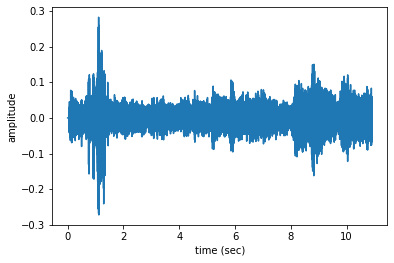

In [ ]:
n=0
fs = None # Sampling frequency
x, fs = librosa.load(files[n],sr=fs)
t = np.arange(len(x))/fs
plt.plot(t,x)
plt.xlabel('time (sec)')
plt.ylabel('amplitude')
plt.show()
display(ipd.Audio(files[n]))

* Mel-frequency cepstral coefficients (MFCCs)

In audio sound processing, the mel-frequency cepstrum (MFC) is a representation of the short-term power spectrum of a sound, based on a linear cosine transform of a log power spectrum on a nonlinear mel scale of frequency which is a spectral representation of the audio clip where frequency warping can allow for better representation of sound.

(20, 940)


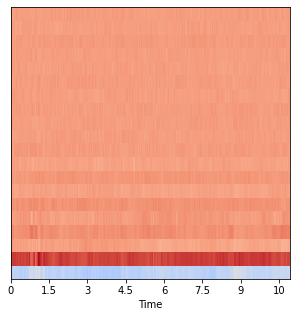

In [ ]:
import librosa.display
mfccs = librosa.feature.mfcc(x, fs)
print(mfccs.shape)

#Displaying  the MFCCs:
plt.figure(figsize=(5, 5))
librosa.display.specshow(mfccs, sr=fs, x_axis='time')

# 5 Modelling
The model used here is A support vector machine (SVM) which is a supervised machine learning model that uses classification algorithms for two-group classification problems. After giving an SVM model sets of labeled training data for each category, they're able to categorize it.

This model is the best for this data becuase it has no overfitting or underfitting of data. The data is almost approximate.

#6 Methodology

The train data snd test data have the same accuracy which shows that model used is good as there is no overfitting or underfitting, means the model is fit using all the data points and the prediction for each data point is compared with its actual output.

#7 Dataset

In [ ]:
from google.colab import drive

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os, sys, re, pickle, glob
import urllib.request
import zipfile

import IPython.display as ipd
from tqdm import tqdm
import librosa

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
path = '/content/drive/MyDrive/Data/MLEndLS'
os.listdir(path)

['MLEndLS_1.zip',
 'MLEndLS_3.zip',
 'MLEndLS_4.zip',
 'Folder4',
 'Folder5',
 'Folder2',
 'Folder1',
 'df_test1.csv',
 'Folder7']

In [ ]:
directory_to_extract_to = '/content/drive/MyDrive/Data/MLEndLS/Folder7/'
zip_path = '/content/drive/MyDrive/Data/MLEndLS/MLEndLS_3.zip'
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(directory_to_extract_to)

In [ ]:
sample_path = '/content/drive/MyDrive/Data/MLEndLS/Folder7/*.wav'
files = glob.glob(sample_path)
len(files)

500

In [ ]:
for _ in range(100):
  n = np.random.randint(500)
  display(ipd.Audio(files[n]))

In [ ]:
MLENDLS_df = pd.read_csv('./MLEndLS.csv').set_index('file_id') 
MLENDLS_df

,area,spot,in_out,Participant
file_id,,,,
0001.wav,british,street,outdoor,S151
0002.wav,kensington,dinosaur,indoor,S127
0003.wav,campus,square,outdoor,S18
0004.wav,kensington,hintze,indoor,S179
0005.wav,campus,square,outdoor,S176
...,...,...,...,...
2496.wav,westend,trafalgar,outdoor,S151
2497.wav,campus,square,outdoor,S6
2498.wav,westend,national,indoor,S96


In [ ]:
for file in files:
  print(file.split('/')[-1])

1001.wav
1002.wav
1003.wav
1004.wav
1005.wav
1006.wav
1007.wav
1008.wav
1009.wav
1010.wav
1011.wav
1012.wav
1013.wav
1014.wav
1015.wav
1016.wav
1017.wav
1018.wav
1019.wav
1020.wav
1021.wav
1022.wav
1023.wav
1024.wav
1025.wav
1026.wav
1027.wav
1028.wav
1029.wav
1030.wav
1031.wav
1032.wav
1033.wav
1034.wav
1035.wav
1036.wav
1037.wav
1038.wav
1039.wav
1040.wav
1041.wav
1042.wav
1043.wav
1044.wav
1045.wav
1046.wav
1047.wav
1048.wav
1049.wav
1050.wav
1051.wav
1052.wav
1053.wav
1054.wav
1055.wav
1056.wav
1057.wav
1058.wav
1059.wav
1060.wav
1061.wav
1062.wav
1063.wav
1064.wav
1065.wav
1066.wav
1067.wav
1068.wav
1069.wav
1070.wav
1071.wav
1072.wav
1073.wav
1074.wav
1075.wav
1076.wav
1077.wav
1078.wav
1079.wav
1080.wav
1081.wav
1082.wav
1083.wav
1084.wav
1085.wav
1086.wav
1087.wav
1088.wav
1089.wav
1090.wav
1091.wav
1092.wav
1093.wav
1094.wav
1095.wav
1096.wav
1097.wav
1098.wav
1099.wav
1100.wav
1101.wav
1102.wav
1103.wav
1104.wav
1105.wav
1106.wav
1107.wav
1108.wav
1109.wav
1110.wav
1111.wav
1

In [ ]:
MLENDLS_df.loc[files[n].split('/')[-1]]

area            campus
spot           library
in_out         outdoor
Participant       S154
Name: 1329.wav, dtype: object

In [ ]:
def getPitch(x,fs,winLen=0.02):
  #winLen = 0.02 
  p = winLen*fs
  frame_length = int(2**int(p-1).bit_length())
  hop_length = frame_length//2
  f0, voiced_flag, voiced_probs = librosa.pyin(y=x, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
  return f0,voiced_flag

In [ ]:
def getXy(files,labels_file, scale_audio=False, onlySingleDigit=False):
  X,y =[],[]
  for file in tqdm(files):
    fileID = file.split('/')[-1]
    file_name = file.split('/')[-1]
    yi = labels_file.loc[fileID]['in_out']=='indoor'

    fs = None # if None, fs would be 22050
    x, fs = librosa.load(file,sr=fs)
    if scale_audio: x = x/np.max(np.abs(x))
    f0, voiced_flag = getPitch(x,fs,winLen=0.02)
      
    power = np.sum(x**2)/len(x)
    pitch_mean = np.nanmean(f0) if np.mean(np.isnan(f0))<1 else 0
    pitch_std  = np.nanstd(f0) if np.mean(np.isnan(f0))<1 else 0
    voiced_fr = np.mean(voiced_flag)

    xi = [power,pitch_mean,pitch_std,voiced_fr]
    X.append(xi)
    y.append(yi)

  return np.array(X),np.array(y)

In [ ]:
X,y = getXy(files, labels_file=MLENDLS_df, scale_audio=True, onlySingleDigit=True)

100%|██████████| 500/500 [11:42<00:00,  1.40s/it]


In [ ]:
print('The shape of X is', X.shape) 
print('The shape of y is', y.shape)
print('The labels vector is', y)


The shape of X is (500, 4)
The shape of y is (500,)
The labels vector is [ True False False False  True  True False False  True False  True  True
  True  True  True False False False False  True False  True False False
 False  True False False  True False  True False  True  True  True  True
  True  True  True False  True  True False  True  True False False False
 False  True False  True False False  True  True  True  True  True False
  True  True False False  True  True False  True  True False  True  True
 False False  True False  True  True False False False False  True  True
 False False False  True  True  True False  True  True  True False False
  True False  True False  True  True  True False False False False  True
 False False  True  True False  True False  True False False False  True
  True False  True False  True  True False False  True  True False False
  True  True  True False  True False  True  True  True False  True  True
 False  True  True False  True  True  True False  T

# 8 Results

In [ ]:
print(' The number of indoor recordings is ', np.count_nonzero(y))
print(' The number of outdoor recordings is ', y.size - np.count_nonzero(y))

 The number of indoor recordings is  244
 The number of outdoor recordings is  256


In [ ]:
from sklearn import svm
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(X,y,test_size=0.3)
X_train.shape, X_val.shape, y_train.shape, y_val.shape

((350, 4), (150, 4), (350,), (150,))

In [ ]:
model  = svm.SVC(C=1)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.54
Validation  Accuracy 0.5133333333333333
The support vectors are (333, 4)


In [ ]:
mean = X_train.mean(0)
sd =  X_train.std(0)

X_train = (X_train-mean)/sd
X_val  = (X_val-mean)/sd

model  = svm.SVC(C=1,gamma=2)
model.fit(X_train,y_train)

yt_p = model.predict(X_train)
yv_p = model.predict(X_val)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))
print('The support vectors are', model.support_vectors_.shape)

Training Accuracy 0.7342857142857143
Validation  Accuracy 0.48
The support vectors are (320, 4)


#9 Conclusions
The SVM  model predicts the training data and validation data to be almost approximate which concludes that this model is the best for this promblem as there is no over fitting of data.